<center>
<h1 id="setting_up_K_means">PREDICTED CHURN RATE OF CREDIT CARD BY FINANCIAL HABITS </h1>
<center>

### Problem Statement:
A manager at the bank is disturbed with more and more customers leaving their credit card services. They would really appreciate if one could predict for them who is gonna get churned so they can proactively go to the customer to provide them better services and turn customers' decisions in the opposite direction. <br>

I got this dataset from a website with the URL as https://leaps.analyttica.com/home. I have been using this for a while to get datasets and accordingly work on them to produce fruitful results.<br>

Now, this dataset consists of 10,000 customers mentioning their age, salary, marital_status, credit card limit, credit card category, etc. There are nearly 18 features.

Datasource: https://www.kaggle.com/sakshigoyal7/credit-card-customers

1. Problem Statment:Dataset information:<br>

**CLIENTNUM** : Client number. Unique identifier for the customer holding the account <br>
**Attrition_Flag** : Internal event (customer activity) variable - if the account is closed then 1 else 0 <br>
**Customer_Age:** Demographic variable - Customer's Age in Years<br>
**Gender:** Demographic variable - M=Male, F=Female<br>
**Dependent_count:** Demographic variable - Number of dependents<br>
**Education_Level:** Demographic variable - Educational Qualification of the account holder (example: high school, college graduate, etc.)<br>
**Marital_Status:** Demographic variable - Married, Single, Divorced, Unknown<br>
**Income_Category:** Demographic variable - Annual Income Category of the account holder (< 40K, 40K - 60K, 60K - 80K, 80K-120K, > 120K, Unknown) <br>
**Card_Category:** Product Variable - Type of Card (Blue, Silver, Gold, Platinum) <br>
**Months_on_book:** Period of relationship with bank<br>
**Total_Relationship_Count:** Total no. of products held by the customer <br>
**Months_Inactive_12_mon:** No. of months inactive in the last 12 months <br>
**Contacts_Count_12_mon:** No. of Contacts in the last 12 months <br>
**Credit_Limit:** Credit Limit on the Credit Card <br>
**Total_Revolving_Bal:** Total Revolving Balance on the Credit Card <br>
**Avg_Open_To_Buy:** Open to Buy Credit Line (Average of last 12 months) <br>
**Total_Amt_Chng_Q4_Q1:** Change in Transaction Amount (Q4 over Q1) <br>
**Total_Trans_Amt:** Total Transaction Amount (Last 12 months) <br>
**Total_Trans_Ct:** Total Transaction Count (Last 12 months) <br>
**Total_Ct_Chng_Q4_Q1:** Change in Transaction Count (Q4 over Q1) <br>
**Avg_Utilization_Ratio:** Average Card Utilization Ratio. <br>

<h3>Table of contents</h3>
<div class="alert alert-success" style="margin-top:15px">
    <u
       <li><font color='blue'>Module 1: Import Library and Dataset</li><br>
    <u
       <li>Module 2: Data Cleaning</li><br>
    <u
       <li>Module 3: Data Wrangling</li><br>
    <u
       <li>Module 4: EDA - Exploratory Data Analysis</li>
                <li><a><font color='black'>1. Demographic Analysis</a></li>
                <li><a><font color='black'>2. Credit Products Analysis</a></li>
    <uI. 
       <li>Module 5: Model Development</li>
                <li><a><font color='black'>Preprocessing</a></li>
                <li><a><font color='black'>Train-Test Splitting</a></li>
                <li><a><font color='black'>Using SMOTE to upscale training set</a></li>
                <li><a><font color='black'>Evaluation again with SMOTE</a></li>
            </ol>
    </ul>
</div>
<hr>

Require following library:

In [32]:
#Processing Data
import pandas as pd
import numpy as np
import warnings
import datetime as dt
import tkinter

#Visualization
%matplotlib inline
import matplotlib
matplotlib.matplotlib_fname()

import matplotlib.pyplot as plt
from matplotlib import colors
import plotly.express as px
import plotly.graph_objs as go
import seaborn as sns

from yellowbrick.cluster import KElbowVisualizer
from pandas_profiling import ProfileReport

#Machine Learning:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler,PolynomialFeatures
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split,cross_val_score
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score, recall_score, roc_auc_score, precision_score
from sklearn.metrics import plot_confusion_matrix
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif
from sklearn.metrics import f1_score as f1
from sklearn.metrics import confusion_matrix
from imblearn.over_sampling import SMOTE

# Module 1: Import Dataset

In [33]:
data = pd.read_csv('BankChurners.csv')
data = data[data.columns[:-2]]
data.head()

,CLIENTNUM,Attrition_Flag,Customer_Age,Gender,Dependent_count,Education_Level,Marital_Status,Income_Category,Card_Category,Months_on_book,...,Months_Inactive_12_mon,Contacts_Count_12_mon,Credit_Limit,Total_Revolving_Bal,Avg_Open_To_Buy,Total_Amt_Chng_Q4_Q1,Total_Trans_Amt,Total_Trans_Ct,Total_Ct_Chng_Q4_Q1,Avg_Utilization_Ratio
0,768805383,Existing Customer,45,M,3,High School,Married,$60K - $80K,Blue,39,...,1,3,12691.0,777,11914.0,1.335,1144,42,1.625,0.061
1,818770008,Existing Customer,49,F,5,Graduate,Single,Less than $40K,Blue,44,...,1,2,8256.0,864,7392.0,1.541,1291,33,3.714,0.105
2,713982108,Existing Customer,51,M,3,Graduate,Married,$80K - $120K,Blue,36,...,1,0,3418.0,0,3418.0,2.594,1887,20,2.333,0.000
3,769911858,Existing Customer,40,F,4,High School,Unknown,Less than $40K,Blue,34,...,4,1,3313.0,2517,796.0,1.405,1171,20,2.333,0.760
4,709106358,Existing Customer,40,M,3,Uneducated,Married,$60K - $80K,Blue,21,...,1,0,4716.0,0,4716.0,2.175,816,28,2.500,0.000


# Module 2: Data Cleaning

### 1. Check N/A and null Value

In [34]:
start_time = dt.datetime.now()
print("Started at ", start_time)

Started at  2021-10-19 11:46:52.186880


In [4]:
report = ProfileReport(data)

In [5]:
report

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [35]:
data.describe().T.style.bar(subset=['mean'], color='mako')\
                            .background_gradient(subset=['std'], cmap='Set2')\
                            .background_gradient(subset=['mean'], cmap='Set2')\
                            .background_gradient(subset=['max'], cmap = 'crest')\
                            .background_gradient(subset=['min'], cmap = 'Paired')

,count,mean,std,min,25%,50%,75%,max
CLIENTNUM,10127.000000,739177606.333663,36903783.450231,708082083.000000,713036770.500000,717926358.000000,773143533.000000,828343083.000000
Customer_Age,10127.000000,46.325960,8.016814,26.000000,41.000000,46.000000,52.000000,73.000000
Dependent_count,10127.000000,2.346203,1.298908,0.000000,1.000000,2.000000,3.000000,5.000000
Months_on_book,10127.000000,35.928409,7.986416,13.000000,31.000000,36.000000,40.000000,56.000000
Total_Relationship_Count,10127.000000,3.812580,1.554408,1.000000,3.000000,4.000000,5.000000,6.000000
Months_Inactive_12_mon,10127.000000,2.341167,1.010622,0.000000,2.000000,2.000000,3.000000,6.000000
Contacts_Count_12_mon,10127.000000,2.455317,1.106225,0.000000,2.000000,2.000000,3.000000,6.000000
Credit_Limit,10127.000000,8631.953698,9088.776650,1438.300000,2555.000000,4549.000000,11067.500000,34516.000000
Total_Revolving_Bal,10127.000000,1162.814061,814.987335,0.000000,359.000000,1276.000000,1784.000000,2517.000000
Avg_Open_To_Buy,10127.000000,7469.139637,9090.685324,3.000000,1324.500000,3474.000000,9859.000000,34516.000000


Data has no null value. Now we check to see any outliers

### 2. Check Outlier

In [36]:
Q1 = data.quantile(0.25)
Q3 = data.quantile(0.75)
IQR = Q3 - Q1
lower = Q1 - 1.5 * IQR
upper = Q3 + 1.5 * IQR
detect = ((data < (lower)) | (data > (upper))).sum()
detect

C:\Users\ADMINI~1\AppData\Local\Temp/ipykernel_4784/3757575831.py:6: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version.  Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  detect = ((data < (lower)) | (data > (upper))).sum()
C:\Users\ADMINI~1\AppData\Local\Temp/ipykernel_4784/3757575831.py:6: FutureWarning: Automatic reindexing on DataFrame vs Series comparisons is deprecated and will raise ValueError in a future version.  Do `left, right = left.align(right, axis=1, copy=False)` before e.g. `left == right`
  detect = ((data < (lower)) | (data > (upper))).sum()


Attrition_Flag                0
Avg_Open_To_Buy             963
Avg_Utilization_Ratio         0
CLIENTNUM                     0
Card_Category                 0
Contacts_Count_12_mon       629
Credit_Limit                984
Customer_Age                  2
Dependent_count               0
Education_Level               0
Gender                        0
Income_Category               0
Marital_Status                0
Months_Inactive_12_mon      331
Months_on_book              386
Total_Amt_Chng_Q4_Q1        396
Total_Ct_Chng_Q4_Q1         394
Total_Relationship_Count      0
Total_Revolving_Bal           0
Total_Trans_Amt             896
Total_Trans_Ct                2
dtype: int64

<Figure size 432x288 with 0 Axes>

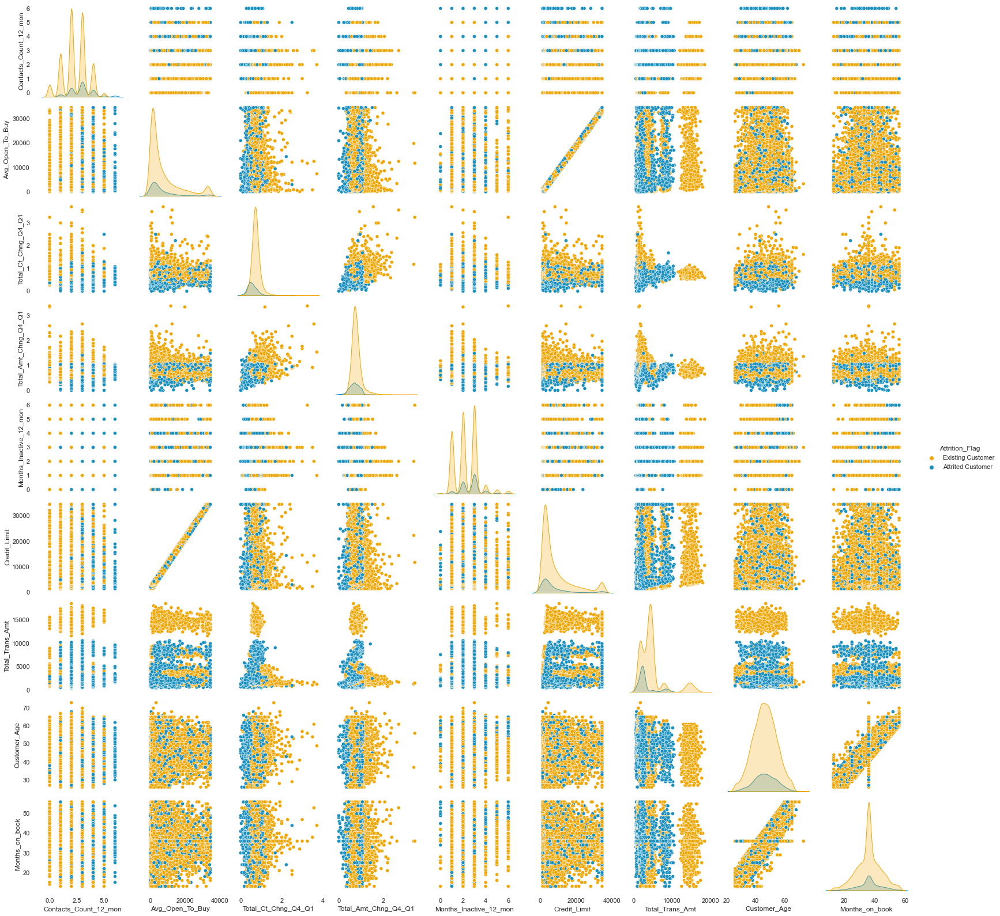

In [37]:
# Visualize Outlier
# Set color for graph
sns.set(rc={"axes.facecolor":"#FFFFFF","figure.facecolor":"#FFFFFF"})
pallet = ["#f0a500", "#178fbf", "#57CC99", "#57CC99", "#055052", "#08FFC8"]
cmap = colors.ListedColormap(["#22577A", "#38A3A5", "#57CC99", "#57CC99", "#055052", "#08FFC8"])

#Plotting following features
To_Plot = ["Contacts_Count_12_mon",'Avg_Open_To_Buy','Total_Ct_Chng_Q4_Q1','Total_Amt_Chng_Q4_Q1', "Months_Inactive_12_mon", "Credit_Limit", "Total_Trans_Amt", "Customer_Age", "Months_on_book", "Attrition_Flag"]
plt.figure()
figure1 = sns.pairplot(data[To_Plot], hue= "Attrition_Flag", palette= (["#f0a500", "#178fbf"]))
plt.show()

First of all, we will choose feature that have the range outside of IQR.
- Contacts_Count_12_mon, Months_Inactive_12_mon, and Total_Trans_Amt display multimodal distribution => It has underlying groups in the data.

- Avg_Open_To_Buy,Total_Ct_Chng_Q4_Q1,Total_Amt_Chng_Q4_Q1, Credit_Limit, Total_Trans_Amt are positive skew. => There are too many extreme value that cause this problem.

- Customer Age , and Month on Book are Leptokurtic.

With many non-normal distribution data, Support Vector Machine and Decision Tree/ RandomForest seem to be the right classification algorithm to predict the dataset, since two algorithmns do not care about normal distribution.

Next, we will explore and analyse the dataset.

# Module 3: Data Wrangling

In [38]:
#Group Customer Age:
data.loc[(data['Customer_Age'] >= 13) & (data['Customer_Age'] <= 19), 'AgeGroup'] = 'Teen'
data.loc[(data['Customer_Age'] >= 20) & (data['Customer_Age']<= 39), 'AgeGroup'] = 'Adult'
data.loc[(data['Customer_Age'] >= 40) & (data['Customer_Age'] <= 59), 'AgeGroup'] = 'Middle Age Adult'
data.loc[(data['Customer_Age'] >= 60), 'AgeGroup'] = 'Senior Adult'

In [39]:
rename = {
    '$120K +' : '120+K',
    '$40K - $60K' : '40-60K',
    '$60K - $80K' : '60-80K',
    '$80K - $120K' : '80-120K',
    'Less than $40K' : '-40K',
    'Unknown' : 'Unknown'
}
data['Income_Category'] = data['Income_Category'].map(rename)

In [40]:
cols_del = ['CLIENTNUM']
data = data.drop(cols_del, axis=1)

# Module 4: EDA

### 1. Demographic Analysis:
For this analysis, we would overview these features: <Br> 
- Customer Age
- Dependents Count
- Education
- Marital Status
- Gender

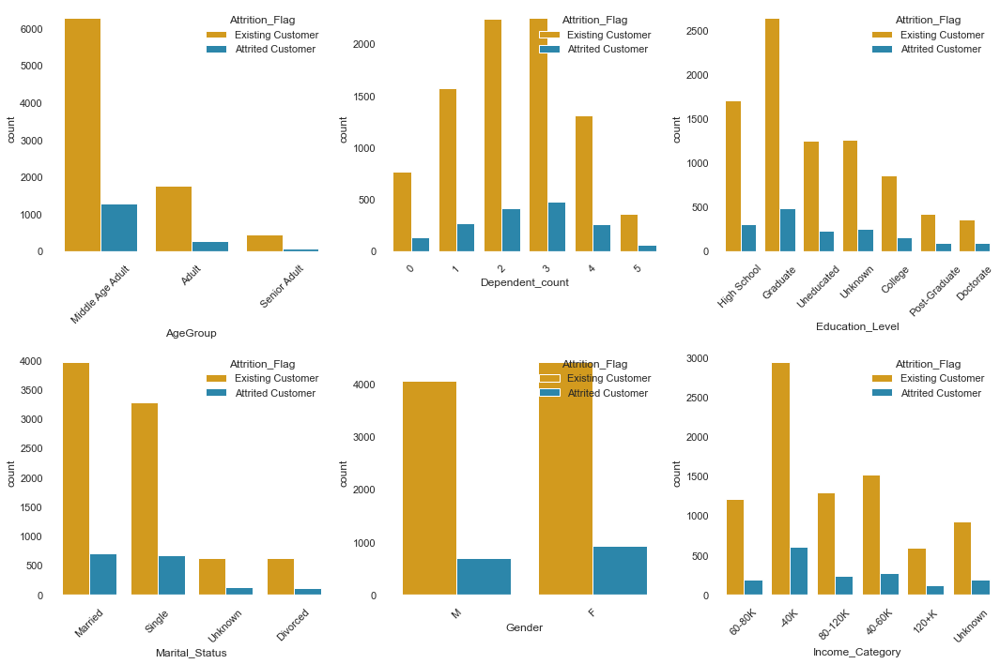

In [41]:
feature_select = ["AgeGroup", "Dependent_count", "Education_Level", "Marital_Status", "Gender", 'Income_Category']
plt.figure(figsize = (15, 10))
for i in enumerate(feature_select):  
    plt.subplot(2, 3,i[0]+1)
    ax = sns.countplot(x=data[i[1]], hue=data['Attrition_Flag'], palette=["#f0a500", "#178fbf"])
    plt.xticks(rotation = 45)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

<font color='red'>**Observation**:</font><br> In customer demographic, the existing and churn customers are quite the same.<br>
- The age of most customers is Middle Age, around 40 to 59 years olds;
- They have 2, 3 dependents;
- Their education is graduated. 70% have formal education level, and 35% customers have higher level of education;
- Most of them are married, and single;
- Female customers have taken a larger portion, however, the gap between male and female customers is not large;  
- Most of users have income category less than 40,000 USD.

### 2. Credit Product:
Then, we would overview which products they used:  <Br> 
- Card_Category
- Total_Relationship_Count

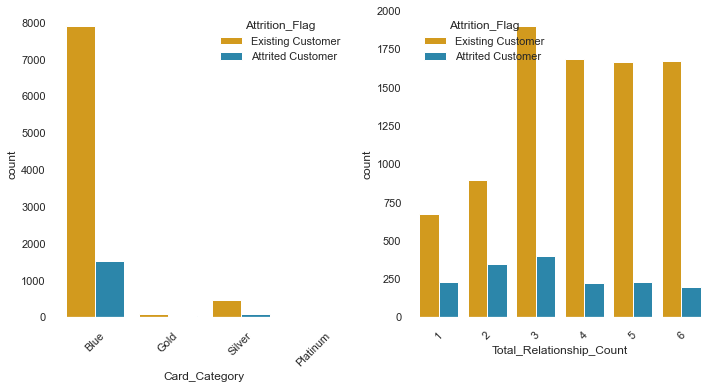

In [42]:
product_related = ['Card_Category', 'Total_Relationship_Count']
plt.figure(figsize = (15, 10))
for i in enumerate(product_related):  
    plt.subplot(2, 3,i[0]+1)
    ax = sns.countplot(x=data[i[1]], hue=data['Attrition_Flag'], palette=["#f0a500", "#178fbf"])
    plt.xticks(rotation = 45)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

<font color='red'>**Observation**:</font><br>
- Card Type mostly used is Blue card. For churn customers, the total transaction amount is in range of 1000 to 5000. On the other hand, existing customers has total transaction from 12,500 to 17,500. Platinum and Gold are the least users.
- Total products held by customers is around, 3 to 6 products

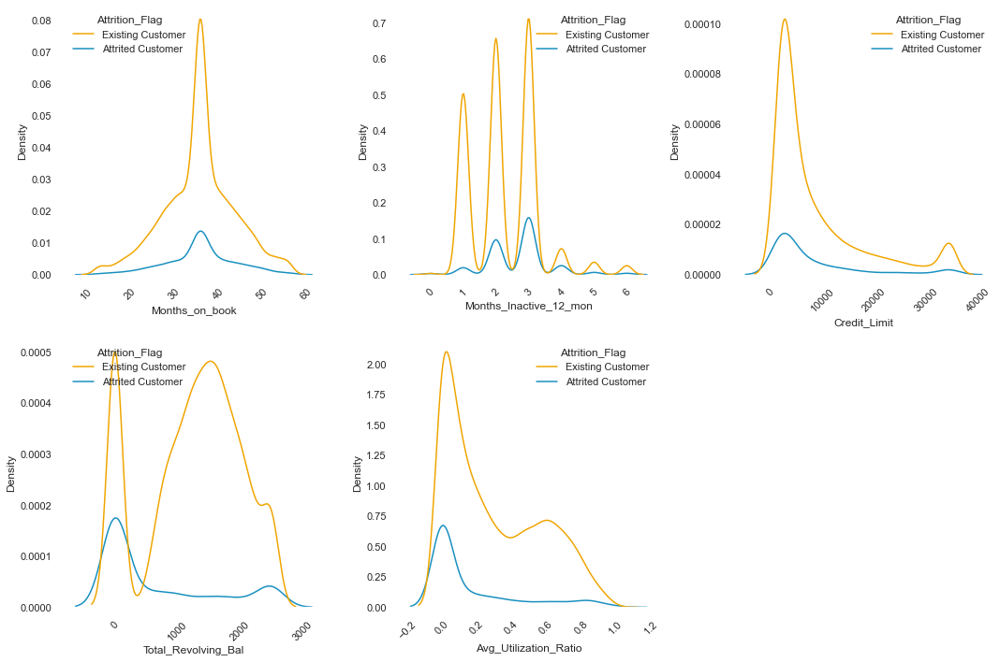

In [43]:
credit_related = ['Months_on_book', 'Months_Inactive_12_mon', 'Credit_Limit','Total_Revolving_Bal', 'Avg_Utilization_Ratio']
plt.figure(figsize = (15, 10))
for i in enumerate(credit_related):  
    plt.subplot(2, 3,i[0]+1)
    ax = sns.kdeplot(data = data, x=i[1], hue='Attrition_Flag', palette=["#f0a500", "#178fbf"])
    plt.xticks(rotation = 45)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [44]:
print('Kurtosis of Months on book features is : {}'.format(data['Months_on_book'].kurt()))

Kurtosis of Months on book features is : 0.40010012019986707


<font color='red'>**Observation**:</font><br>
- Month on book: The relationship with bank mostly is around 30 - 40 months. Since the kurtosis is quite low, with extreme value round 36, therefore, I can not assume the normality of the feature.<br>
- Inactive in last 12 months: Most of users have inactive 1 - 3 months.<br>
- Credit limit has positive skew. Most of its is from range 1,000 to 10,000<br>
- Total Revolving Balance is really high regarding to existing customers. The credit status seem good due to the average utilization ratio is reducing.

In [45]:
attri_count = data['Attrition_Flag'].value_counts()
attri_count = attri_count.to_frame().reset_index()
attri_count.columns = ['Attrition_Flag', 'count']   
attri_count = attri_count.sort_values('Attrition_Flag', ascending = True)

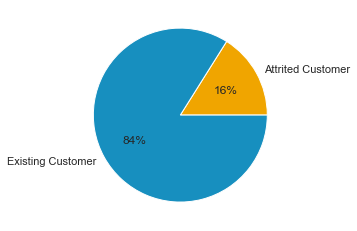

In [46]:
colors = sns.color_palette(["#f0a500", "#178fbf"])
label = attri_count['Attrition_Flag']
count_value = attri_count['count']
ax1 = plt.pie(x = count_value, labels = label, colors = colors, autopct='%.0f%%')
plt.show()

There are only 16% data samples represent churns customers. Therefore, in order to train model more effectively we would use upsample method. But first, we need to transform category variable into one hot encode.

# Module 5: Model Developing

Before applying classification algorithms, I would check how raw data perform regarding to precision and recall with Random Forest and SVC to see which one is suitable. Then, I will apply SMOTE to upscall training set, since the imbalanace data. But first, I would like to implement the One-Hot Encode and Feature Selection.<br>
The following content: <br>
- I. Preprocessing
- II. Train-Test Splitting
- III. Evaluation with Raw Data
- IV. Using SMOTE to upscale training set
- V. Evaluation again with SMOTE.

## I. Preprocessing

### 1. One-hot encode

In [47]:
# One hot encode all categorial variable
data.Attrition_Flag = data.Attrition_Flag.replace({'Attrited Customer':1,'Existing Customer':0})
data.Gender = data.Gender.replace({'F':1,'M':0})
data = pd.concat([data,pd.get_dummies(data['Education_Level']).drop(columns=['Unknown'])],axis=1)
data = pd.concat([data,pd.get_dummies(data['Income_Category']).drop(columns=['Unknown'])],axis=1)
data = pd.concat([data,pd.get_dummies(data['Marital_Status']).drop(columns=['Unknown'])],axis=1)
data = pd.concat([data,pd.get_dummies(data['Card_Category']).drop(columns=['Platinum'])],axis=1)
data.drop(columns = ['Education_Level','Income_Category','Marital_Status','Card_Category','AgeGroup'],inplace=True)

### 2. Correlation Matrix

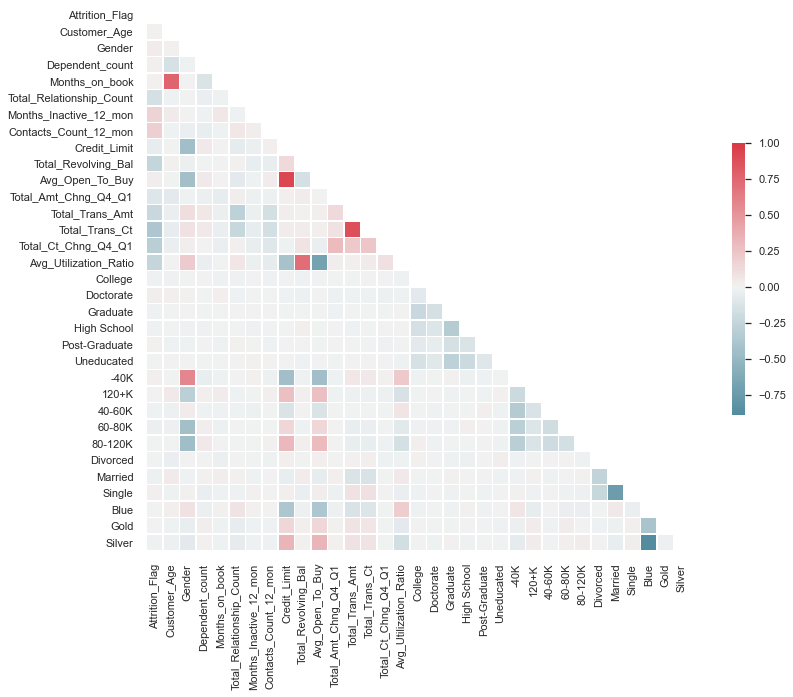

In [48]:
sns.set(style='white')
# Compute the correlation matrix
corr = data.corr('spearman')
# Generate a mask for the upper triangle
mask = np.zeros_like(corr)
mask[np.triu_indices_from(mask)] = True
# Set up the matplotlib figure:
f, ax = plt.subplots(figsize=(15, 10))
# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)
# Draw the heatmap with a mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=1, center=0, square=True, linewidths=.5, cbar_kws={"shrink": .5})
plt.show()

## II. Train-Test Split

In [49]:
X = data.drop(columns = 'Attrition_Flag')
y = data['Attrition_Flag']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0, shuffle = True, stratify = y)

In [50]:
X_train.dtypes

Customer_Age                  int64
Gender                        int64
Dependent_count               int64
Months_on_book                int64
Total_Relationship_Count      int64
Months_Inactive_12_mon        int64
Contacts_Count_12_mon         int64
Credit_Limit                float64
Total_Revolving_Bal           int64
Avg_Open_To_Buy             float64
Total_Amt_Chng_Q4_Q1        float64
Total_Trans_Amt               int64
Total_Trans_Ct                int64
Total_Ct_Chng_Q4_Q1         float64
Avg_Utilization_Ratio       float64
College                       uint8
Doctorate                     uint8
Graduate                      uint8
High School                   uint8
Post-Graduate                 uint8
Uneducated                    uint8
-40K                          uint8
120+K                         uint8
40-60K                        uint8
60-80K                        uint8
80-120K                       uint8
Divorced                      uint8
Married                     

In [51]:
print(y_train.value_counts())
print(y_test.value_counts())

0    6799
1    1302
Name: Attrition_Flag, dtype: int64
0    1701
1     325
Name: Attrition_Flag, dtype: int64


### Feature Selection (ANOVA Testing)

In [52]:
# feature selection by using ANOVA testing
def select_features(X_train, y_train, X_test):
    # configure to select all features
    fs = SelectKBest(score_func=f_classif, k='all') # learn relationship from training data
    fs.fit(X_train, y_train)
    # transform train input data
    X_train_fs = fs.transform(X_train)
    # transform test input data
    X_test_fs = fs.transform(X_test)
    return X_train_fs, X_test_fs, fs

Feature 0: 3.214688
Feature 1: 13.307409
Feature 2: 2.452783
Feature 3: 1.605786
Feature 4: 197.132389
Feature 5: 190.624123
Feature 6: 374.555688
Feature 7: 4.796743
Feature 8: 575.257440
Feature 9: 0.012793
Feature 10: 143.545053
Feature 11: 235.333091
Feature 12: 1296.485010
Feature 13: 760.844648
Feature 14: 257.048611
Feature 15: 0.152012
Feature 16: 14.723538
Feature 17: 0.308971
Feature 18: 2.336854
Feature 19: 0.183510
Feature 20: 0.277121
Feature 21: 7.765824
Feature 22: 1.061649
Feature 23: 3.009905
Feature 24: 5.970709
Feature 25: 0.582673
Feature 26: 0.302234
Feature 27: 3.562101
Feature 28: 1.137079
Feature 29: 0.097996
Feature 30: 0.387355
Feature 31: 0.015028


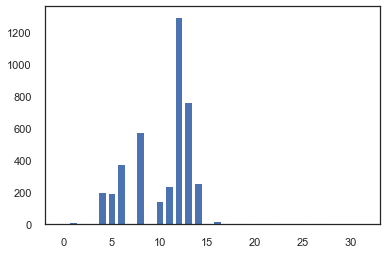

In [53]:
# feature selection
X_train_fs, X_test_fs, fs = select_features(X_train, y_train, X_test)
# what are scores for the features
for i in range(len(fs.scores_)):
    print('Feature %d: %f' % (i, fs.scores_[i]))
# plot the scores
plt.bar([i for i in range(len(fs.scores_))], fs.scores_)
plt.show()

Feature 4, 5, 6, 8, 10, 11, 12, 13, 14 are the most relevent.

In [54]:
feature_relevant = [4,5,6,8,10,11,12,13,14]
for i in feature_relevant:
    print(data.columns[i])

Months_on_book
Total_Relationship_Count
Months_Inactive_12_mon
Credit_Limit
Avg_Open_To_Buy
Total_Amt_Chng_Q4_Q1
Total_Trans_Amt
Total_Trans_Ct
Total_Ct_Chng_Q4_Q1


## III. Evaluation with Raw Data

#### Random Forest Classification Method

In [55]:
RFC = RandomForestClassifier(random_state = 0)
RFC.fit(X_train_fs,y_train)
print("Accuracy: %.2f%%" % ((RFC.score(X_test,y_test))*100.0))

Accuracy: 95.71%


In [56]:
y_pred = RFC.predict(X_test)
precision_recall_fscore_support(y_test, y_pred, average='binary',pos_label=1,beta = 1)
print(classification_report(y_test,y_pred))
print("Accuracy: %.2f%%" % (accuracy_score(y_test, y_pred)*100.0))
print("Recall: %.2f%%" % ((recall_score(y_test,y_pred))*100.0))

              precision    recall  f1-score   support

           0       0.96      0.99      0.97      1701
           1       0.95      0.77      0.85       325

    accuracy                           0.96      2026
   macro avg       0.95      0.88      0.91      2026
weighted avg       0.96      0.96      0.96      2026

Accuracy: 95.71%
Recall: 77.23%


Confusion matrix, without normalization
[[1688   13]
 [  74  251]]
Normalized confusion matrix
[[0.99235744 0.00764256]
 [0.22769231 0.77230769]]


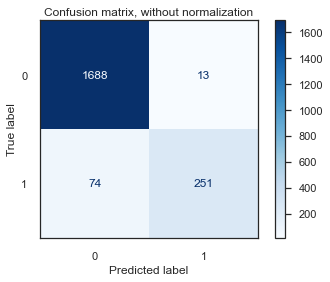

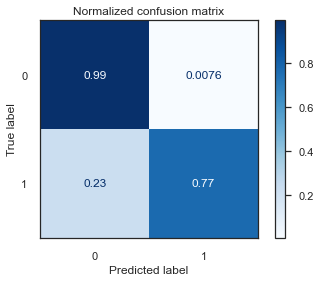

In [57]:
titles_options = [("Confusion matrix, without normalization", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(
        RFC, X_test, y_test, display_labels=RFC.classes_,
        cmap=plt.cm.Blues, normalize=normalize
    )
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

In [58]:
from sklearn.metrics import jaccard_score
jaccard_score(y_test, y_pred,pos_label=0)

0.9509859154929577

Recall is only 77% because the churn customers has only 16%, lead to the training sets reduce dramatically. The solution for this method is using Upscaling method to balanced the dataset by using SMOTE.

#### Support Vector Classification Method

In [64]:
SVC_method = SVC(kernel = 'rbf')
SVC_method.fit(X_train_fs,y_train)
print("Accuracy: %.2f%%" % ((SVC_method.score(X_test,y_test))*100.0))

Accuracy: 83.96%


In [65]:
y_pred_svc = SVC_method.predict(X_test)
precision_recall_fscore_support(y_test, y_pred_svc, average='binary',pos_label=1,beta = 1)
print(classification_report(y_test,y_pred_svc))
print("Accuracy: %.2f%%" % (accuracy_score(y_test, y_pred_svc)*100.0))
print("Recall: %.2f%%" % ((recall_score(y_test,y_pred_svc))*100.0))

              precision    recall  f1-score   support

           0       0.84      1.00      0.91      1701
           1       0.00      0.00      0.00       325

    accuracy                           0.84      2026
   macro avg       0.42      0.50      0.46      2026
weighted avg       0.70      0.84      0.77      2026

Accuracy: 83.96%
Recall: 0.00%


C:\Users\Administrator\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Administrator\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Administrator\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1245: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
C:\Users\Administrator\anaconda3\lib\si

<font color='red'>**With using raw data for train, split test, we can clearly see that Random Forest has more precision, and recall than Support Vector Classification.**</font>

### IV. Using SMOTE to upscale training set

**Why using SMOTE?**:<br>
Due to imbalance dataset (only 16% churn customers), one approach to solve this problems is duplicating examples in the minority class, and then synthesized from the existing examples. Therefore, Synthetic Minority Oversampling Technique or SMOTE is suitable.

"SMOTE first selects a minority class instance a at random and finds its k nearest minority class neighbors. The synthetic instance is then created by choosing one of the k nearest neighbors b at random and connecting a and b to form a line segment in the feature space. The synthetic instances are generated as a convex combination of the two chosen instances a and b." <br>
*Page 47, Imbalanced Learning: Foundations, Algorithms, and Applications, 2013*

In [62]:
from imblearn.over_sampling import BorderlineSMOTE
from imblearn.under_sampling import RandomUnderSampler

from imblearn.pipeline import Pipeline
from collections import Counter

In [66]:
sm = SMOTE(sampling_strategy='auto', random_state=1234)
x_sm, y_sm = sm.fit_resample(X_train_fs, y_train)

print(Counter(y_train))
print(Counter(y_sm))

Counter({0: 6799, 1: 1302})
Counter({0: 6799, 1: 6799})


In [67]:
over = BorderlineSMOTE(sampling_strategy=0.3)
under = RandomUnderSampler(sampling_strategy=0.6)

steps = [('o', over), ('u', under)]

In [69]:
pipeline = Pipeline(steps=steps)

# transform the dataset
x_sm_us, y_sm_us = pipeline.fit_resample(X_train_fs, y_train)

print(Counter(y_train))
print(Counter(y_sm_us))

Counter({0: 6799, 1: 1302})
Counter({0: 3398, 1: 2039})


In [70]:
RFC = RandomForestClassifier(random_state = 0)
RFC.fit(x_sm_us,y_sm_us)
print("Accuracy: %.2f%%" % ((RFC.score(x_sm_us,y_sm_us))*100.0))

Accuracy: 100.00%


In [71]:
y_pred = RFC.predict(X_test)
precision_recall_fscore_support(y_test, y_pred, average='binary',pos_label=1,beta = 1)
print(classification_report(y_test,y_pred))
print("Accuracy: %.2f%%" % (accuracy_score(y_test, y_pred)*100.0))
print("Recall: %.2f%%" % ((recall_score(y_test,y_pred))*100.0))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98      1701
           1       0.90      0.88      0.89       325

    accuracy                           0.97      2026
   macro avg       0.94      0.93      0.94      2026
weighted avg       0.97      0.97      0.97      2026

Accuracy: 96.54%
Recall: 88.31%


Confusion matrix, without normalization
[[1669   32]
 [  38  287]]
Normalized confusion matrix
[[0.98118754 0.01881246]
 [0.11692308 0.88307692]]


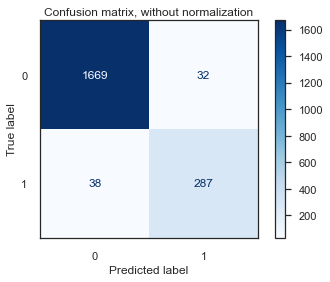

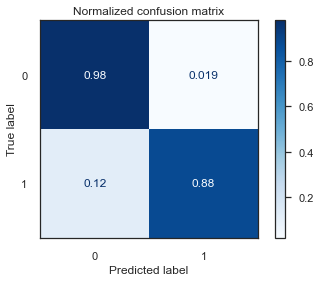

In [72]:
titles_options = [("Confusion matrix, without normalization", None),
                  ("Normalized confusion matrix", 'true')]
for title, normalize in titles_options:
    disp = plot_confusion_matrix(
        RFC, X_test, y_test, display_labels=RFC.classes_,
        cmap=plt.cm.Blues, normalize=normalize
    )
    disp.ax_.set_title(title)

    print(title)
    print(disp.confusion_matrix)

plt.show()

As we saw that the recall level has been increased from 77% to 88%.

In [79]:
features_to_plot = 25
feature_name = list((X).columns)
importances = RFC.feature_importances_
indices = np.argsort(importances)

best_vars = np.array(feature_name)[indices][-features_to_plot:]
values = importances[indices][-features_to_plot:]
best_vars

array(['Divorced', 'Uneducated', '40-60K', 'High School', '80-120K',
       'Graduate', '-40K', '60-80K', 'Single', 'Married', 'Gender',
       'Dependent_count', 'Months_on_book', 'Credit_Limit',
       'Avg_Open_To_Buy', 'Customer_Age', 'Months_Inactive_12_mon',
       'Contacts_Count_12_mon', 'Avg_Utilization_Ratio',
       'Total_Relationship_Count', 'Total_Amt_Chng_Q4_Q1',
       'Total_Revolving_Bal', 'Total_Ct_Chng_Q4_Q1', 'Total_Trans_Amt',
       'Total_Trans_Ct'], dtype='<U24')

In [86]:
from matplotlib.pyplot import figure

C:\Users\ADMINI~1\AppData\Local\Temp/ipykernel_4784/554019776.py:5: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.set_yticklabels(best_vars)


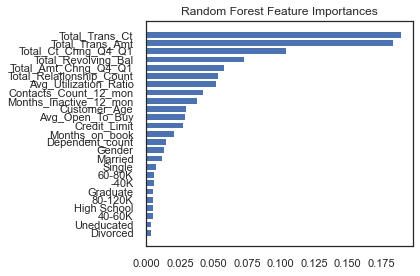

<Figure size 1440x1440 with 0 Axes>

In [91]:
y_ticks = np.arange(0, features_to_plot)
fig, ax = plt.subplots()
figure(figsize=(20, 20))
ax.barh(y_ticks, values)
ax.set_yticklabels(best_vars)
ax.set_yticks(y_ticks)
ax.set_title("Random Forest Feature Importances")
fig.tight_layout(rect=[0, 0, 1, 1])
plt.show(20,20)

In order to avoid over-fitting, we would choose the first 10 features.